# Laboratorio 1

## Caso
Los sondeos astronómicos han emergido como herramientas fundamentales en la exploración del universo, permitiendo el estudio detallado de una amplia gama de objetos celestes. Estas exhaustivas observaciones proporcionan datos cruciales que impulsan nuestra comprensión de la evolución cósmica, desde los primeros momentos del universo hasta su estructura a gran escala. Su relevancia radica en la capacidad para revelar patrones, tendencias y fenómenos astronómicos, abriendo nuevas fronteras en la investigación cósmica.

Uno de los sondeos más recientes es StarAlpes, cuyo objetivo es el estudio de objetos celestes en el universo, con el fin de entender fenómenos cósmicos que desafían nuestras concepciones previas. Estos extensos relevamientos nos permiten examinar una amplia variedad de sucesos astronómicos, desde la formación y evolución de galaxias hasta la actividad de cuásares distantes, pasando por la expansión continúa del universo.
Es en este punto donde StarAlpes ha visto la oportunidad de analizar información del primer conjunto de datos obtenidos por su telescopio principal y ver si una solución basada en analítica con el uso de aprendizaje automático puede aportar en el logro de sus objetivos.
Es relacionado con esa iniciativa que StarAlpes decidió contratarlo como científico de datos para que a partir del conjunto de datos compartido pueda aportar en el desarrollo de este estilo de proyectos que realizará la colaboración.

Este último en particular requiere de la medición del corrimiento al rojo (redshift) de los objetos observados por su telescopio principal para determinar su distancia a la Tierra y su velocidad de alejamiento (a mayor distancia, mayor velocidad de alejamiento). Sin embargo, el cálculo del corrimiento requiere técnicas como la espectroscopia para analizar los elementos que componen los objetos observados y establecer un valor de corrimiento aproximado. Los costos en tiempo y recursos de usar instrumentos de espectroscopia para calcular las velocidades de todos los objetos en un sondeo se han vuelto prohibitivos al aumentar la cantidad de detecciones, haciendo casi imposible poder calcular el corrimiento de todas y cada una de las observaciones realizadas por el telescopio.

## Los datos

ra: Ascención de la coordenada celeste.

dec: Declinación de la coordenada celeste.

u: Magnitud en el filtro ultravioleta

g: Magnitud en el filtro verde.

r: Magnitud en el filtro rojo.

z: Magnitud en el filtro casi-infrarojo.

run: Número de observaciones por telescopio.

camcol: Columna de la cámara.

field: Sección de la columna de la cámara.

score (numeric): Calidad 0 o 1

clean (numeric): Confiabilidad 0 o 1

class (char): Tipo. STAR, GALAXY o QSO

redshift: Corrimiento al rojo

mjd: Día juliano

rowv: Velocidad horizontal

colv: Velocidad vertical

In [352]:
import numpy as np
import pandas as pd

from joblib import dump, load

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, FunctionTransformer,OneHotEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

import scipy.stats as stats

# 1. Carga de datos

Se cargan los datos

In [353]:
db_location = "/content/202510_Laboratorio 1 - Regresión_train_data.csv"

In [354]:
telescope_df= pd.read_csv(db_location, sep=',', encoding="ISO-8859-1")

In [355]:
telescope_df.shape

(4000, 18)

Se mira el ejemplo de los primeros 5 datos del dataframe

In [356]:
telescope_df.sample(5)

,objid,ra,dec,u,g,r,i,z,run,camcol,field,score,clean,class,redshift,mjd,rowv,colv
1064,1237648704052592668,211.666335,-0.357285,19.30768,17.50772,16.56380,16.12247,15.74522,752,3,455,0.864704,1,GALAXY,0.113011,51688,-0.003940,-0.010881
3454,1237648720134668606,128.987349,-1.021521,19.56273,18.56784,18.26005,18.12045,18.12742,756,1,88,0.858762,1,STAR,0.001035,56745,0.001540,-0.000167
2227,1237648721233117315,185.468128,-0.140998,17.75666,16.05942,15.35988,15.05300,14.93230,756,3,465,0.882993,1,STAR,0.000211,54140,0.002169,0.001611
3692,1237648705668645158,224.148555,0.988396,18.64145,16.99837,16.19786,15.68261,15.33547,752,6,538,0.882815,1,GALAXY,0.079597,52029,-0.014898,0.014410
1859,1237648721790697923,232.792406,0.402831,18.52934,16.66912,15.81866,15.40350,15.09536,756,4,781,0.861673,1,GALAXY,0.038944,51989,0.004584,0.001904


# 1.2 Manipulación básica

Ver tipos de dato

In [357]:
telescope_df.dtypes

,0
objid,int64
ra,float64
dec,float64
u,float64
g,float64
r,float64
i,float64
z,float64
run,int64
camcol,int64


Todos los datos son numéricos a excepción de "class", el cuál es categórico.

In [358]:
number_cols = telescope_df.dtypes[(telescope_df.dtypes == np.int64) | (telescope_df.dtypes == np.float64)].index
number_cols = telescope_df.select_dtypes(include = ['int','float']).columns
number_cols

Index(['objid', 'ra', 'dec', 'u', 'g', 'r', 'i', 'z', 'run', 'camcol', 'field',
       'score', 'clean', 'redshift', 'mjd', 'rowv', 'colv'],
      dtype='object')

Al observar una muestra de los datos y el diccionario, se observa que clean es 0 o 1, por lo que podría ser categórico. Además, al ver el mínimo y el máximo de cada columna, no se debe redimensionar ninguna variable porque coincide con los rangos dados en el diccionario.

In [359]:
telescope_df[number_cols].describe()

,objid,ra,dec,u,g,r,i,z,run,camcol,field,score,clean,redshift,mjd,rowv,colv
count,4.000000e+03,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.00000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000
mean,1.237649e+18,185.523295,0.248959,18.609049,17.363397,16.839856,16.597712,16.439392,743.829000,3.37625,419.602000,0.851765,0.895500,0.134015,52957.124750,0.000218,-0.000090
std,4.244222e+11,41.689446,2.001075,0.839431,0.950964,1.055343,1.141252,1.190502,98.865936,1.69909,167.162063,0.071311,0.305946,0.379742,1601.148131,0.008794,0.007457
min,1.237646e+18,10.469743,-1.252763,13.551780,12.974870,12.362850,12.010790,11.799530,211.000000,1.00000,19.000000,0.301912,0.000000,-0.003322,51608.000000,-0.264516,-0.168807
25%,1.237649e+18,162.474666,-0.631824,18.170375,16.796110,16.190785,15.870782,15.628205,752.000000,2.00000,311.000000,0.836866,1.000000,0.000106,51821.000000,-0.001212,-0.001609
50%,1.237649e+18,195.815451,0.053336,18.843745,17.472525,16.850835,16.571195,16.402665,756.000000,3.00000,434.000000,0.860675,1.000000,0.032038,51986.000000,0.000322,0.000125
75%,1.237649e+18,214.348425,0.593396,19.261563,17.997818,17.506640,17.258833,17.147037,756.000000,5.00000,527.000000,0.879834,1.000000,0.086479,54468.000000,0.001698,0.001672
max,1.237650e+18,249.758313,13.854010,19.599750,22.497450,22.265960,28.179630,20.847690,1035.000000,6.00000,812.000000,0.961145,1.000000,4.192597,58932.000000,0.181871,0.128814


Se corrobora que todos los valores de clean cumplan con ser 0 o 1

In [360]:
telescope_df.clean.value_counts()

,count
clean,
1,3582
0,418


# 2. Entendimiento de los datos
## 2.1 Perfilamiento de datos

In [361]:
telescope_df.shape

(4000, 18)

In [362]:
telescope_df.describe()

,objid,ra,dec,u,g,r,i,z,run,camcol,field,score,clean,redshift,mjd,rowv,colv
count,4.000000e+03,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.00000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000
mean,1.237649e+18,185.523295,0.248959,18.609049,17.363397,16.839856,16.597712,16.439392,743.829000,3.37625,419.602000,0.851765,0.895500,0.134015,52957.124750,0.000218,-0.000090
std,4.244222e+11,41.689446,2.001075,0.839431,0.950964,1.055343,1.141252,1.190502,98.865936,1.69909,167.162063,0.071311,0.305946,0.379742,1601.148131,0.008794,0.007457
min,1.237646e+18,10.469743,-1.252763,13.551780,12.974870,12.362850,12.010790,11.799530,211.000000,1.00000,19.000000,0.301912,0.000000,-0.003322,51608.000000,-0.264516,-0.168807
25%,1.237649e+18,162.474666,-0.631824,18.170375,16.796110,16.190785,15.870782,15.628205,752.000000,2.00000,311.000000,0.836866,1.000000,0.000106,51821.000000,-0.001212,-0.001609
50%,1.237649e+18,195.815451,0.053336,18.843745,17.472525,16.850835,16.571195,16.402665,756.000000,3.00000,434.000000,0.860675,1.000000,0.032038,51986.000000,0.000322,0.000125
75%,1.237649e+18,214.348425,0.593396,19.261563,17.997818,17.506640,17.258833,17.147037,756.000000,5.00000,527.000000,0.879834,1.000000,0.086479,54468.000000,0.001698,0.001672
max,1.237650e+18,249.758313,13.854010,19.599750,22.497450,22.265960,28.179630,20.847690,1035.000000,6.00000,812.000000,0.961145,1.000000,4.192597,58932.000000,0.181871,0.128814


### 2.2 Datos categóricos

Se miran los valores de class

In [363]:
telescope_df['class'].value_counts()

,count
class,
GALAXY,1857
STAR,1629
QSO,292
S,177
G,44
QUASAR,1


In [364]:
telescope_df['class'].value_counts(dropna=False, normalize=True)

,proportion
class,
GALAXY,0.46425
STAR,0.40725
QSO,0.07300
S,0.04425
G,0.01100
QUASAR,0.00025


Se puede evidenciar que los presentan mayor cantidad de datos son galaxy, star y qso, por esta razón mas adelante todos los demas pasaran a estas categorias.

# 3 Análisis de calidad de datos

## 3.1 Completitud

In [365]:
((telescope_df.isnull().sum()/telescope_df.shape[0])).sort_values(ascending=False)

,0
objid,0.0
ra,0.0
rowv,0.0
mjd,0.0
redshift,0.0
class,0.0
clean,0.0
score,0.0
field,0.0
camcol,0.0


Se puede evidenciar que no hay nulos

## 3.2 Unicidad

In [366]:
duplicated_rows = telescope_df.loc[telescope_df.duplicated(keep=False)]
duplicated_rows.sort_values(by=duplicated_rows.columns.tolist())

,objid,ra,dec,u,g,r,i,z,run,camcol,field,score,clean,class,redshift,mjd,rowv,colv
114,1237646382079606869,94.679499,0.842321,18.47695,16.94897,16.68126,16.59887,16.51747,211,6,359,0.806204,1,STAR,0.000207,52931,0.000372,-0.001017
3024,1237646382079606869,94.679499,0.842321,18.47695,16.94897,16.68126,16.59887,16.51747,211,6,359,0.806204,1,STAR,0.000207,52931,0.000372,-0.001017
897,1237646382079672642,94.883887,0.990686,17.03847,15.47224,15.10297,14.97051,14.88297,211,6,360,0.806983,1,S,0.000012,52931,-0.001483,0.001376
1735,1237646382079672642,94.883887,0.990686,17.03847,15.47224,15.10297,14.97051,14.88297,211,6,360,0.806983,1,S,0.000012,52931,-0.001483,0.001376
88,1237648703513428079,206.374167,-0.781673,18.28101,17.18856,16.70175,16.33173,16.14626,752,2,420,0.904768,1,GALAXY,0.088136,51943,-0.002860,0.001156
3254,1237648703513428079,206.374167,-0.781673,18.28101,17.18856,16.70175,16.33173,16.14626,752,2,420,0.904768,1,GALAXY,0.088136,51943,-0.002860,0.001156
2609,1237648705132888168,226.621828,0.595329,18.96363,18.67637,18.47234,18.41949,17.96547,752,5,555,0.871417,1,QSO,0.369813,51990,0.002106,-0.000110
3592,1237648705132888168,226.621828,0.595329,18.96363,18.67637,18.47234,18.41949,17.96547,752,5,555,0.871417,1,QSO,0.369813,51990,0.002106,-0.000110
1533,1237648705134461016,230.219374,0.560741,19.42733,19.27966,19.59048,19.86852,20.08571,752,5,579,0.875917,1,STAR,-0.000112,55327,-0.000059,0.000094
1991,1237648705134461016,230.219374,0.560741,19.42733,19.27966,19.59048,19.86852,20.08571,752,5,579,0.875917,1,STAR,-0.000112,55327,-0.000059,0.000094


In [367]:
duplicated_rows.shape[0]

34

Hay 34 filas duplicadas

In [368]:
duplicated_data = telescope_df.loc[telescope_df.duplicated(keep="first")]
duplicated_data.shape[0]

17

Los datos que se repiten en la 34 filas duplicadas son 17 datos

De lo anterior se concluye que hay 34 filas repetidas. Al mantener únicamente la primera aparición del dato, se observa que hay 17 registros repetidos.

## 3.3 Consistencia

### 3.3.1 Categóricos

In [369]:
telescope_df['class'].value_counts()

,count
class,
GALAXY,1857
STAR,1629
QSO,292
S,177
G,44
QUASAR,1


In [370]:
telescope_df.loc[telescope_df["class"] == "G", "class"] = "GALAXY"
telescope_df.loc[telescope_df["class"] == "S", "class"] = "STAR"
telescope_df.loc[telescope_df["class"] == "QUASAR", "class"] = "QSO"


Se realiza limpieza de datos para que correspondieran a la categoría.

In [371]:
telescope_df['class'].value_counts()

,count
class,
GALAXY,1901
STAR,1806
QSO,293


In [372]:
telescope_df[number_cols].describe()

,objid,ra,dec,u,g,r,i,z,run,camcol,field,score,clean,redshift,mjd,rowv,colv
count,4.000000e+03,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.00000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000
mean,1.237649e+18,185.523295,0.248959,18.609049,17.363397,16.839856,16.597712,16.439392,743.829000,3.37625,419.602000,0.851765,0.895500,0.134015,52957.124750,0.000218,-0.000090
std,4.244222e+11,41.689446,2.001075,0.839431,0.950964,1.055343,1.141252,1.190502,98.865936,1.69909,167.162063,0.071311,0.305946,0.379742,1601.148131,0.008794,0.007457
min,1.237646e+18,10.469743,-1.252763,13.551780,12.974870,12.362850,12.010790,11.799530,211.000000,1.00000,19.000000,0.301912,0.000000,-0.003322,51608.000000,-0.264516,-0.168807
25%,1.237649e+18,162.474666,-0.631824,18.170375,16.796110,16.190785,15.870782,15.628205,752.000000,2.00000,311.000000,0.836866,1.000000,0.000106,51821.000000,-0.001212,-0.001609
50%,1.237649e+18,195.815451,0.053336,18.843745,17.472525,16.850835,16.571195,16.402665,756.000000,3.00000,434.000000,0.860675,1.000000,0.032038,51986.000000,0.000322,0.000125
75%,1.237649e+18,214.348425,0.593396,19.261563,17.997818,17.506640,17.258833,17.147037,756.000000,5.00000,527.000000,0.879834,1.000000,0.086479,54468.000000,0.001698,0.001672
max,1.237650e+18,249.758313,13.854010,19.599750,22.497450,22.265960,28.179630,20.847690,1035.000000,6.00000,812.000000,0.961145,1.000000,4.192597,58932.000000,0.181871,0.128814


# 4. Reporte

In [373]:
!pip install ydata_profiling
import ydata_profiling
profiling = ydata_profiling.ProfileReport(telescope_df)
profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 2.1.1 Búsqueda de relaciones con la variable objetivo

Se implementa OneHotEncoder, para pasar de variable categoríca a variable númerica

In [374]:
from sklearn.preprocessing import OneHotEncoder
import pandas as pd

encoder = OneHotEncoder(sparse_output=False, drop='first')  # Eliminamos 'STAR' para evitar colinealidad
X_encoded = encoder.fit_transform(telescope_df[['class']])

column_names = encoder.get_feature_names_out(['class'])
df_encoded = pd.DataFrame(X_encoded, columns=column_names, index=telescope_df.index)

telescope_df = telescope_df.join(df_encoded)


In [375]:
telescope_df = telescope_df[telescope_df['clean'] == 1]

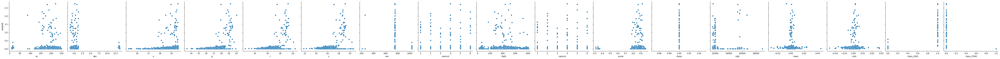

In [376]:
features=["ra","dec","u","g","r","z","run","camcol","field","camcol","score","clean","mjd", "rowv", "colv", "class_QSO","class_STAR"]
g=sns.pairplot(telescope_df.sample(frac=0.2), height=4, y_vars="redshift", x_vars=features, kind="scatter")

En las gráficas se observa que las variables u, g ,r, i y z son las que presentan una mayor tendencia lineal. Variables como dec, clean, score, camcol y run no muestran tendencias que puedan correlacionar con la variable objetivo. Para corroborar lo anterior se hace el heatmap.

### 2.1.2 Búsqueda de relaciones entre variables

<Axes: >

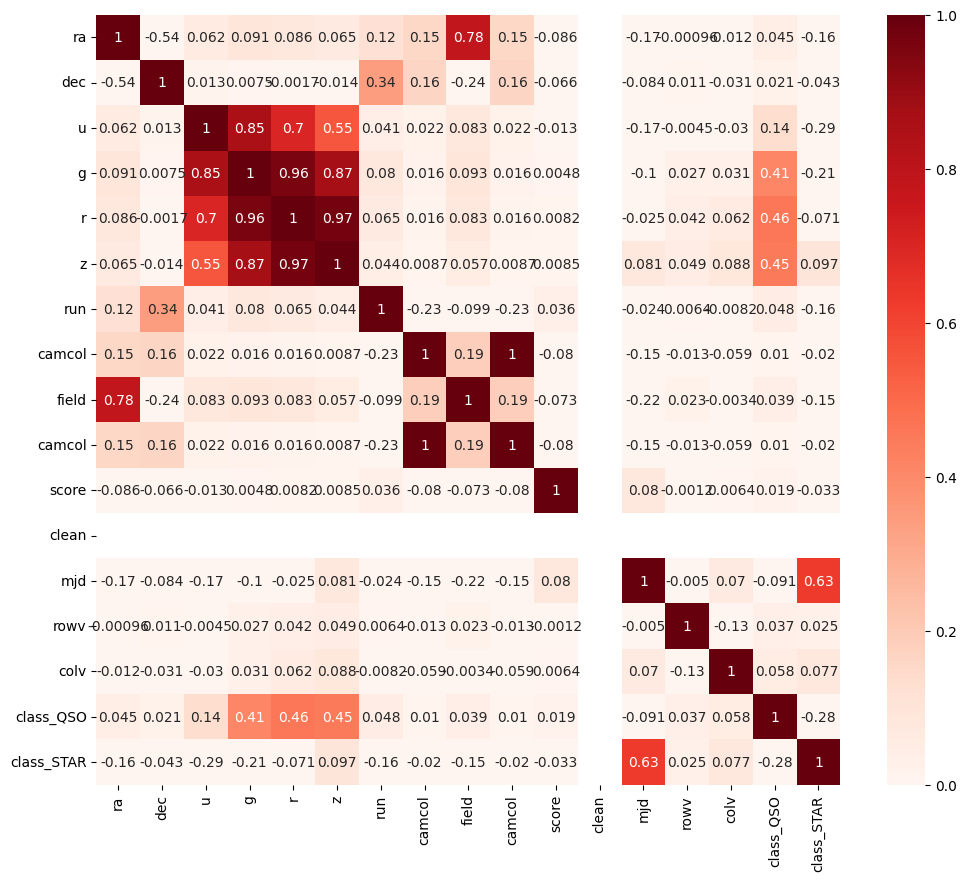

In [377]:
plt.figure(figsize=(12,10))
sns.heatmap((telescope_df[features]).corr(), cmap="Reds", vmin=0, vmax=1, annot=True)

Como se observa en el heatmap, las variables más correlacionadas con la variable objetivo son g, r, i y z, sin embargo, estas variables tienen correlaciones muy altas entre sí (mayores a 0.8), por lo que el modelo se realizará con r y u-g y con class_qso, class_star.

In [378]:
telescope_df['u_g']=(telescope_df["u"]-telescope_df["g"])
telescope_df['i_z']=(telescope_df["r"]-telescope_df["i"])

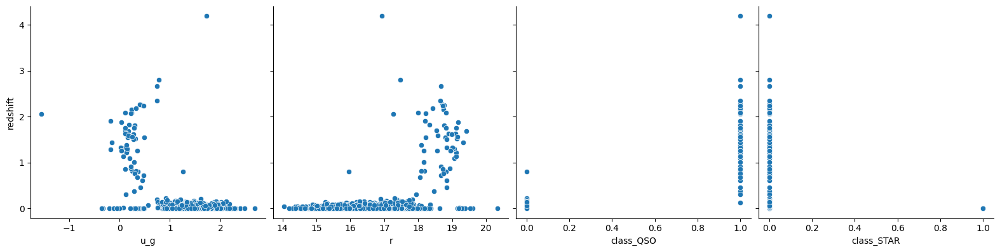

In [379]:
features2=["u_g","r","class_QSO","class_STAR"]
g=sns.pairplot(telescope_df.sample(frac=0.2), height=4, y_vars="redshift", x_vars=features2, kind="scatter")

<Axes: >

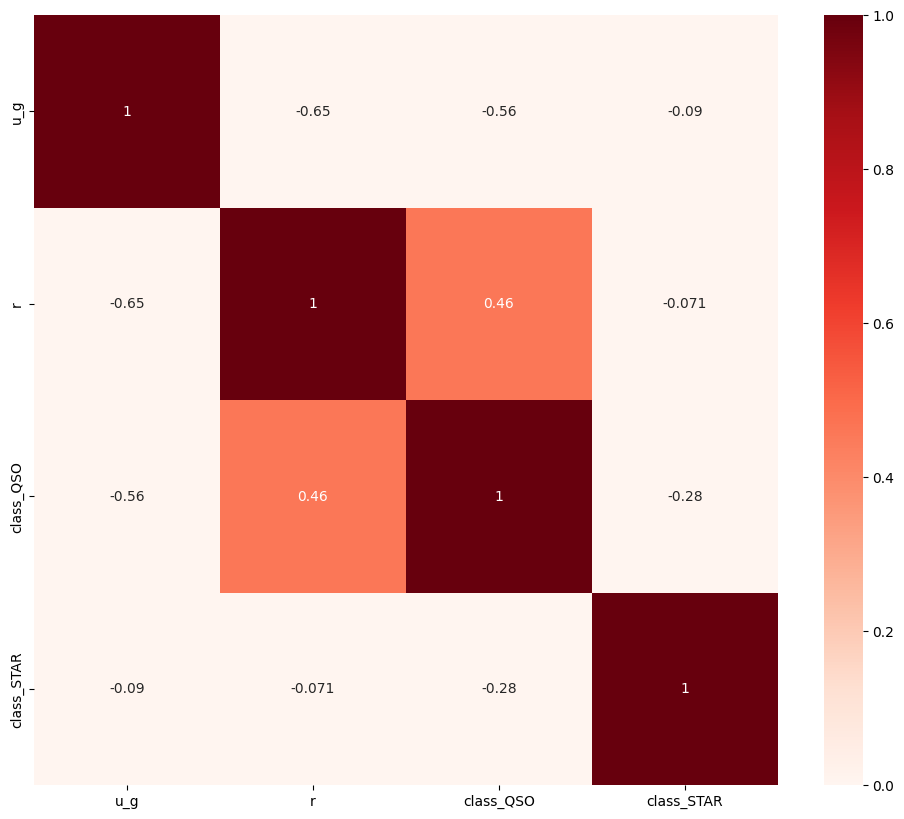

In [380]:
plt.figure(figsize=(12,10))
sns.heatmap((telescope_df[features2]).corr(), cmap="Reds", vmin=0, vmax=1, annot=True)

Se muestra la colinealidad de las variables escogidas.

# 5. Preparción de datos

Se eliminan los datos nulos, como no hay, el dataframe se mantendrá igual.

In [381]:
telescope_df= telescope_df.dropna(subset=["redshift"]+features)
telescope_df.shape

(3582, 22)

Se eliminan los datos duplicados. Al hacer el shape se observa que se eliminaron los 17 datos identificados previamente en el análisis de calidad.

In [382]:
telescope_df=telescope_df.drop_duplicates(subset=features, keep="first")
telescope_df.shape[0]

3566

In [383]:
telescope_df=telescope_df.loc[telescope_df['clean']==1]

# 6. Modelo de regresión lineal

Particionamiento del conjunto de datos en entrenamiento y prueba, se van a separar los datos que recibimos en el archivo "202510_Laboratorio 1 - Regresión_train_data", las variables frente a las cuales se va a realizar el modelo fueron las elegidas anteriormente.

In [384]:
X_train, X_test, y_train, y_test = train_test_split(telescope_df[features2], telescope_df["redshift"], test_size=0.3, random_state=1)

In [385]:
X_train.shape, y_train.shape

((2496, 4), (2496,))

In [386]:
X_test.shape, y_test.shape

((1070, 4), (1070,))

Se va a entrenar el modelo, este va a ser lineal

In [387]:
regression = LinearRegression()

In [388]:
regression.fit(X_train, y_train)

LinearRegression()

Interpretación de los coeficientes y del intercepto

Se explicará cada uno de los coeficientes:


u_g: u es ultravioleta, g es verde. La primera tiene longitud de onda más corta que la otra, al restarlas determinas qué luz predomina más, si ultravioleta o verde. Una es más brillante que la otra, entonces si u-g es positivo o muy alto, es porque hay más ultravioleta que verde y eso significa que el objeto se mueve hacia ti, por lo tanto, la resta y su coeficiente nos indicaran una porción del redshift del cuerpo.


r:  r es la magnitud en el filtro rojo, lo que evidentemente nos indicara la cantidad de redshift que tiene el cuerpo, esto en mayor proporción que el u_g.


class_QSO: debido a su alto coeficiente podemos ver que cuando un dato es de tipo QSO tiene más probabilidad de tener corrimiento al rojo.


class_STAR: debido a su coeficiente negativo, podemos ver que cuando un dato es de tipo STAR tiene más probabilidad de tener corrimiento al rojo negativo, es decir, en realidad se está acercando a nosotros.

In [389]:
pd.DataFrame({"columns": features2, "coef": regression.coef_})

,columns,coef
0,u_g,0.000016
1,r,0.015734
2,class_QSO,1.189637
3,class_STAR,-0.085137


In [390]:
regression.intercept_

-0.17880698874030845

El intercepto representa el redshift esperado con valores cero en las variables. Sin embargo, en la práctica, los valores de magnitudes (como u_g y r) no suelen ser cero, por lo que el intercepto en sí mismo no tiene un significado físico directo, sino que es solo un punto de referencia en la ecuación del modelo.

Calcular el R cuadrado, esto para saber que tan bien esta explicando el modelo, la variablidad de lo datos.

In [391]:
r2_train = r2_score(y_train, regression.predict(X_train))
print("R^2 Train:", r2_train)

# Calcular R^2 para los datos de prueba
r2_test = r2_score(y_test, regression.predict(X_test))
print("R^2 Test:", r2_test)

R^2 Train: 0.743926892497885
R^2 Test: 0.800345179566749


Se pudo evidenciar un R2 cercano a 1, en el train se dio con 0.744 y en el test 0.800, de esta manera se puede evidenciar que es un modelo que puede reflejar la variablidad de los datos.


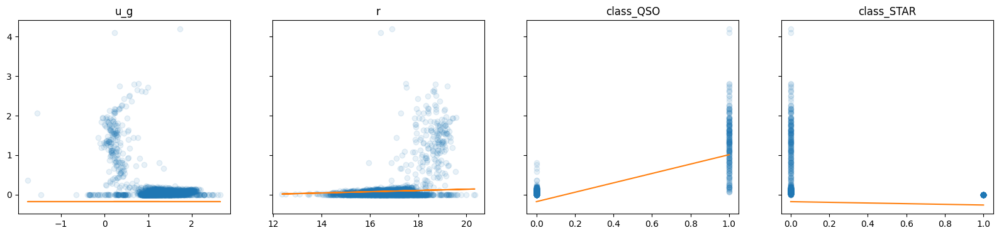

In [392]:
f, axs = plt.subplots(1, len(features2), sharey=True, figsize=(20, 4))

for i in range(len(features2)):
    col = features2[i]
    x = X_train[col]
    m = regression.coef_[i]
    b = regression.intercept_

    axs[i].plot(x, y_train, "o", alpha=0.1)
    axs[i].plot(x, x * m + b)
    axs[i].set_title(col)

Por medio de lo anterior se puedec evidenciar que u_g y r presentan datos principalmente en 0 y unos datos dispersos, mientras que ambas clases de class presentan o valores en 0 en uno puesto a que son categoricas y frente a estas se implemento OneHotEncoder

Validar el modelo, por medio de MAE y RMSE, para saber que tanto se alejan las predicciones frente a la variable objetivo.

**Mean Absolute Error (MAE)**

$$ MAE = {1 \over n}{\sum_{i=1}^n {|y_{i} - y_{i}'|} } $$

In [393]:
print("Train:", mean_absolute_error(y_train, regression.predict(X_train)))
print("Test:", mean_absolute_error(y_test, regression.predict(X_test)))

Train: 0.06491760626287767
Test: 0.05182025868882674


**Root Mean Squeared Error (RMSE)**

$$ RMSE =  \sqrt{{1 \over n}{\sum_{i=1}^n {(y_{i} - y_{i}')^2} } }$$

In [394]:
print("Train:", np.sqrt(mean_squared_error(y_train, regression.predict(X_train))))
print("Test:", np.sqrt(mean_squared_error(y_test, regression.predict(X_test))))

Train: 0.206134518867036
Test: 0.15996188971714945


Análisis del error

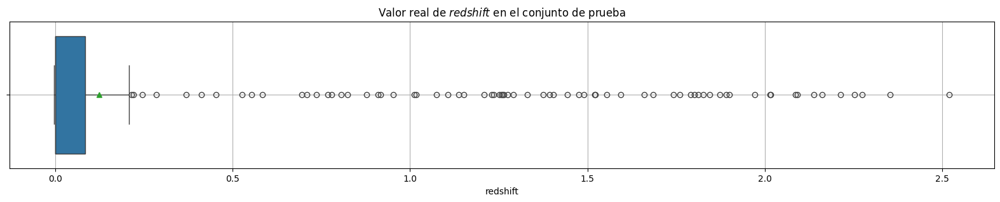

In [395]:
plt.figure(figsize=(20, 3))
sns.boxplot(x=y_test, showmeans=True, orient="h")
plt.title("Valor real de $\t{redshift}$ en el conjunto de prueba")
plt.grid()
plt.show()

Se puede evidenciar una gran de cantidad de outliers

In [396]:
y_test.describe(percentiles=[0.25, 0.5, 0.75, 0.99])

,redshift
count,1070.000000
mean,0.123838
std,0.358162
min,-0.002373
25%,0.000076
50%,0.000920
75%,0.084529
99%,1.984748
max,2.519756


Se puede evidenciar que el valor media es 0,1238 y la desviación de estos es de  0.358162 esta es un poco alta frente a la media de los datos


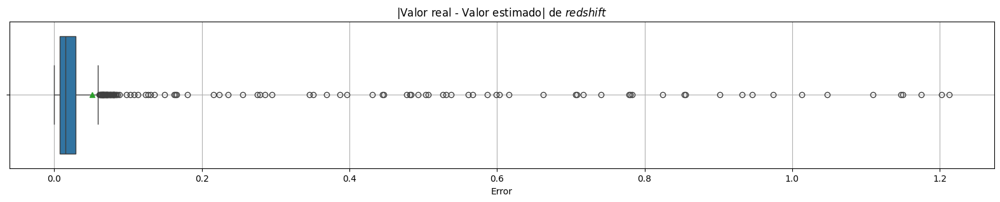

In [397]:
plt.figure(figsize=(20, 3))
sns.boxplot(x=abs(y_test - regression.predict(X_test)), showmeans=True, orient="h")
plt.title("|Valor real - Valor estimado| de $\t{redshift}$")
plt.xlabel("Error")
plt.grid()
plt.show()

In [398]:
abs(y_test-regression.predict(X_test)).describe(percentiles=[0.25, 0.5, 0.75, 0.95, 0.99])

,redshift
count,1070.000000
mean,0.051820
std,0.151406
min,0.000028
25%,0.007612
50%,0.015097
75%,0.028690
95%,0.199793
99%,0.911276
max,1.213047


Se puede evidenciar que la media es 0,051820 y su desviación fue de 0.151406 mostrando una desviación menor que la anterior

# 7.  Validación de supuestos de la regresión

## 7.1 Colinealidad

<Axes: >

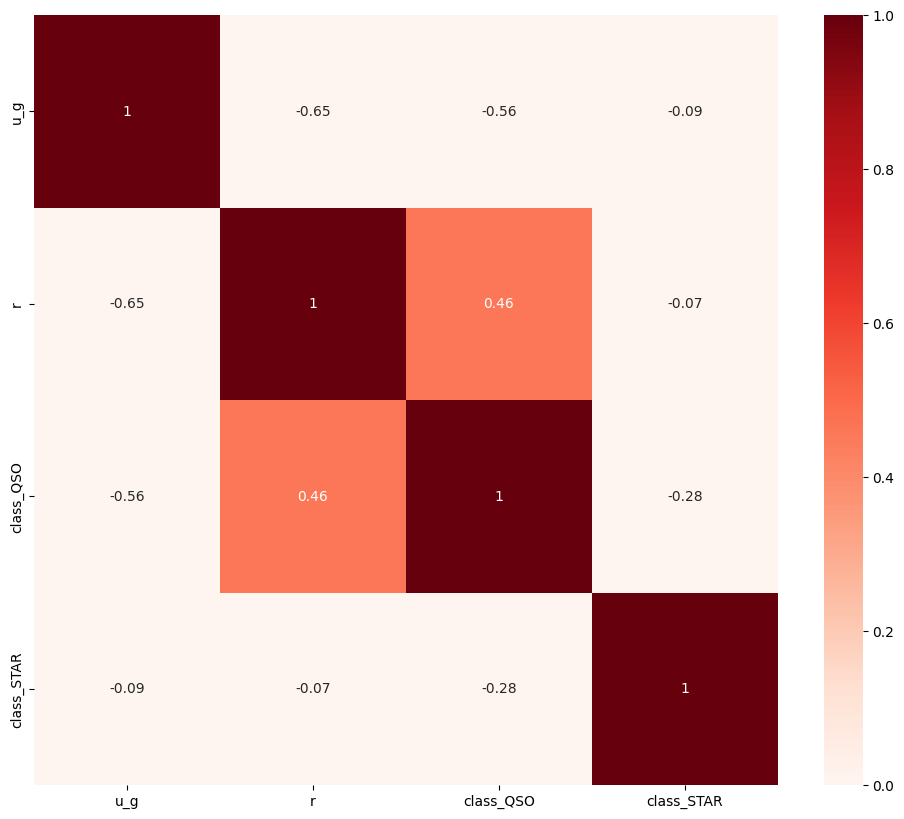

In [399]:
plt.figure(figsize=(12, 10))
#sns.heatmap(X_train.corr(), cmap="Blues", vmin=0, vmax=1)
sns.heatmap((telescope_df[features2]).corr(), cmap="Reds", vmin=0, vmax=1, annot=True)

In [400]:
X_train.corr()

,u_g,r,class_QSO,class_STAR
u_g,1.000000,-0.647802,-0.562747,-0.081555
r,-0.647802,1.000000,0.459724,-0.065842
class_QSO,-0.562747,0.459724,1.000000,-0.289432
class_STAR,-0.081555,-0.065842,-0.289432,1.000000


las variables utilizadas no tienen alta colinealidad, lo cual nos premite decir con certeza qué variable tiene más impacto en la predicción, por llo cual no es necesario deshacerse de ninguna.

##7.2 Linealidad


Para asegurarse que la relación entre cada variable de entrada y la varable objetivo sea lineal se haran diferentes pruebas de linealidad.

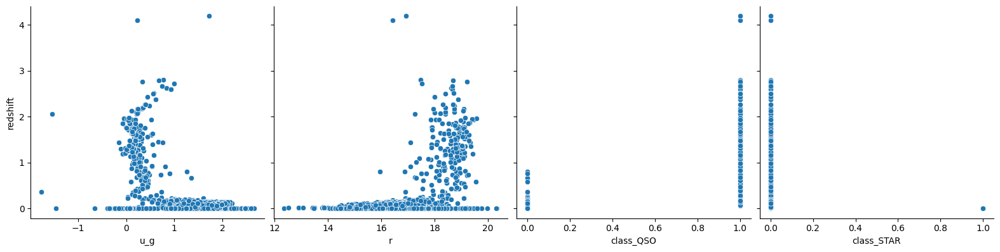

In [401]:
sns.pairplot(pd.concat([X_train, y_train], axis=1),height=4, y_vars="redshift", x_vars=features2, kind="scatter")

In [402]:
pipeline1 = Pipeline(
    [
        ("poly", PolynomialFeatures(degree=2, include_bias=False)),
        ("scaler", StandardScaler()),
        ("model", LinearRegression())
    ]
)

In [403]:
pipeline1.fit(X_train[features2], y_train)

Pipeline(steps=[('poly', PolynomialFeatures(include_bias=False)),
                ('scaler', StandardScaler()), ('model', LinearRegression())])

In [404]:
pd.DataFrame({"columns": pipeline1["poly"].get_feature_names_out(), "coef": pipeline1["model"].coef_})

,columns,coef
0,u_g,-0.324431
1,r,-0.232242
2,class_QSO,-0.327280
3,class_STAR,0.094564
4,u_g^2,0.055615
5,u_g r,0.263648
6,u_g class_QSO,-0.004219
7,u_g class_STAR,-0.012997
8,r^2,0.222277
9,r class_QSO,0.987839


In [405]:
print("MAE:")
print("Train:", mean_absolute_error(y_train, pipeline1.predict(X_train[features2])))
print("Test:", mean_absolute_error(y_test, pipeline1.predict(X_test[features2])))
print("\nRMSE:")
print("Train:", np.sqrt(mean_squared_error(y_train, pipeline1.predict(X_train[features2]))))
print("Test:", np.sqrt(mean_squared_error(y_test, pipeline1.predict(X_test[features2]))))

MAE:
Train: 0.059500296292023705
Test: 0.04730802672003701

RMSE:
Train: 0.2015554682328695
Test: 0.1513726931726992


Debido a que el error si disminuye se podria argumentar que  algunas variables podrian seguir mejor un modelo polinomial. Sin embargo es probable que se deba hacer un mejor estudio de las variables para así poder interpretar de mejor manera los coeficientes.

##7.3 Normalidad de los errores


In [406]:
pipeline = Pipeline(
    [
        ("scaler", StandardScaler()),
        ("model", LinearRegression())
    ]
)

In [407]:
pipeline.fit(X_train[features2], y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('model', LinearRegression())])

In [408]:
errors = (pipeline.predict(X_train[features2])-y_train).values

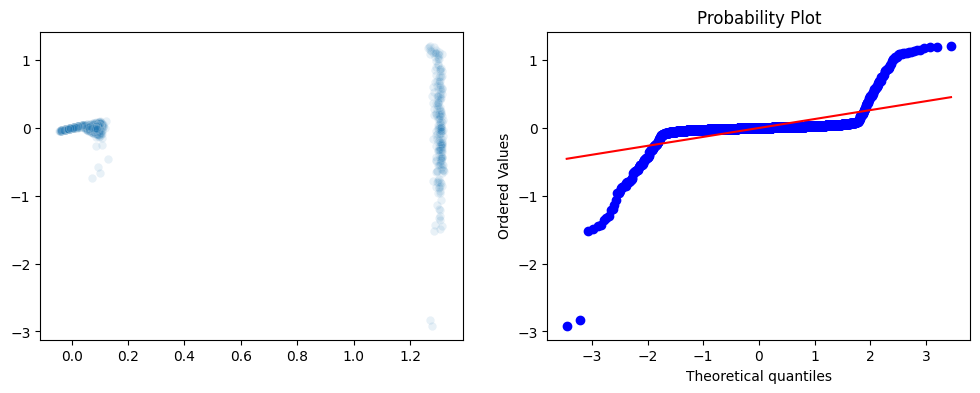

In [409]:
ig, axes = plt.subplots(1, 2, figsize=(12, 4))

# Dispersión
sns.scatterplot(x=pipeline.predict(X_train[features2]), y=errors, alpha=0.1, ax=axes[0])

# q-q plot
_ = stats.probplot(errors, dist="norm", plot=axes[1])

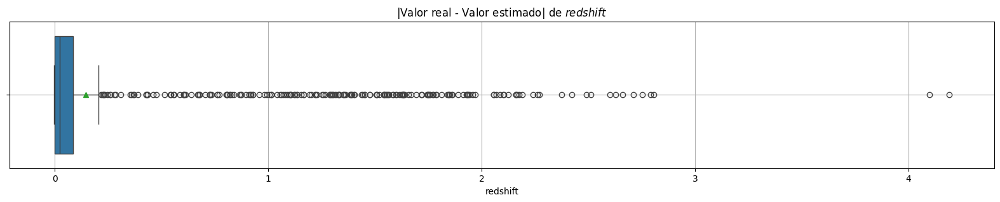

In [410]:
plt.figure(figsize=(20, 3))
sns.boxplot(x=y_train, showmeans=True, orient="h")
plt.title("|Valor real - Valor estimado| de $\t{redshift}$")
plt.grid()
plt.show()

In [411]:
q1 = y_train.quantile(0.25)
q3 = y_train.quantile(0.75)
iqr = q3-q1
threshold = q3+1.5*iqr
threshold

0.21604521344

In [412]:
y_train = y_train.loc[y_train <= threshold]
X_train = X_train.loc[y_train.index]

In [413]:
pipeline.fit(X_train[features2], y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('model', LinearRegression())])

In [414]:
pd.DataFrame({"columns": features2, "coef": pipeline["model"].coef_})

,columns,coef
0,u_g,0.005177
1,r,0.008184
2,class_QSO,0.004936
3,class_STAR,-0.038608


In [415]:
print("MAE:")
print("Train:", mean_absolute_error(y_train, pipeline.predict(X_train[features2])))
print("Test:", mean_absolute_error(y_test, pipeline.predict(X_test[features2])))
print("\nRMSE:")
print("Train:", np.sqrt(mean_squared_error(y_train, pipeline.predict(X_train[features2]))))
print("Test:", np.sqrt(mean_squared_error(y_test, pipeline.predict(X_test[features2]))))

MAE:
Train: 0.0158525334866205
Test: 0.09300427909988218

RMSE:
Train: 0.02406277728159129
Test: 0.34115676179812615


In [416]:
errors = (pipeline.predict(X_train[features2])-y_train).values

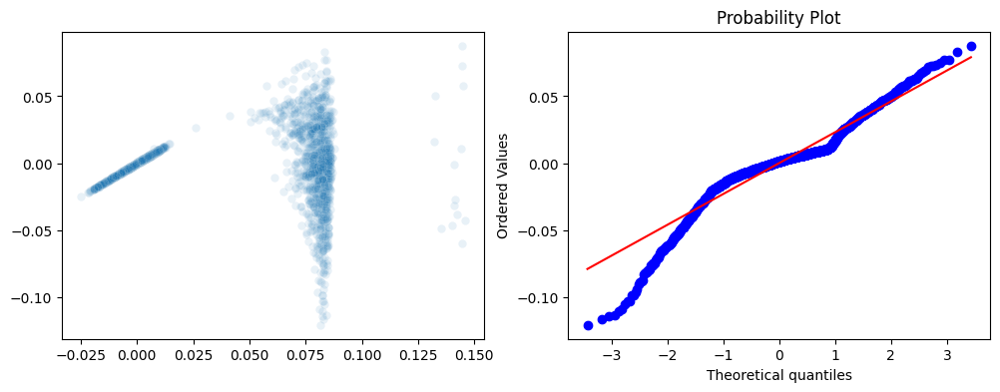

In [417]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

# Dispersión
sns.scatterplot(x=pipeline.predict(X_train[features2]), y=errors, alpha=0.1, ax=axes[0])

# q-q plot
_ = stats.probplot(errors, dist="norm", plot=axes[1])

In [418]:
r2_train = r2_score(y_train, regression.predict(X_train))
print("R^2 Train:", r2_train)

# Calcular R^2 para los datos de prueba
r2_test = r2_score(y_test, regression.predict(X_test))
print("R^2 Test:", r2_test)

R^2 Train: -2.8395528416048794
R^2 Test: 0.800345179566749


Se podría decir que el modelo mejora si se hace la normalización de los errores. Sin embargo, la cantidad de datos atípicos aquí es algo demasiado grande como para ignorar y no tomar en cuenta, por lo tanto, no se separarán en el modelo final.

##7.4 Varianza constante (Homocedasticidad)


<Axes: >

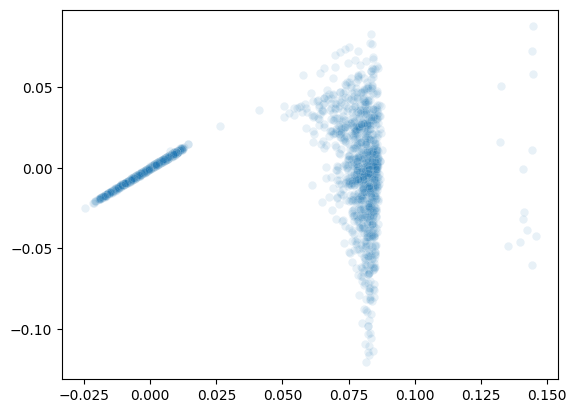

In [419]:
sns.scatterplot(x = pipeline.predict(X_train[features2]), y=errors, alpha=0.1)

Ya que los datos parecen estar acumulados en el centro de la gráfica, el modelo podría no estar capturando correctamente la variabilidad de los datos. Esto podría resolverse aplicando transformaciones no lineales sobre las variables de entrada.


# 8. Implementación del pipeline

Se limpian los datos de las clases

In [420]:
def clean_class_column(X):
    X = X.copy()
    if "class" in X.columns:
        X["class"] = X["class"].replace({"G": "GALAXY", "S": "STAR", "QUASAR": "QSO"})
    return X

Se añade u-g para disminuir colinealidad

In [421]:
def add_u_g(X):
    X = X.copy()
    X["u_g"] = X["u"] - X["g"]
    return X

Determinación de variables a utilizar

In [422]:
numeric_features = ["u_g", "r"]
categorical_features = ["class"]

Creación de Transformers

In [423]:
cleaner = FunctionTransformer(clean_class_column, validate=False)
u_g_transformer = FunctionTransformer(add_u_g, validate=False)

Se añade la transformación para cada variable

In [424]:
preprocessor = ColumnTransformer([
    ("num", StandardScaler(), numeric_features),
    ("cat", OneHotEncoder(sparse_output=False, drop="first"), categorical_features)
])

Se crea el pipeline

In [425]:
pipeline = Pipeline([
    ("cleaning", cleaner),
    ("add_u_g", u_g_transformer),
    ("preprocessor", preprocessor),
    ("model", LinearRegression())
])

Separar en features y variable objetivo

In [426]:

X = telescope_df[["u", "g", "r", "class"]]
y = telescope_df["redshift"]

Partición de datos

In [427]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


Realizar el fit del pipeline

In [428]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('cleaning',
                 FunctionTransformer(func=<function clean_class_column at 0x7fd167b258a0>)),
                ('add_u_g',
                 FunctionTransformer(func=<function add_u_g at 0x7fd167b25ee0>)),
                ('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['u_g', 'r']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['class'])])),
                ('model', LinearRegression())])

Se realiza la transformación de los datos

In [429]:
X_train_cleaned = pipeline.named_steps["cleaning"].transform(X_train)
X_train_with_u_g = pipeline.named_steps["add_u_g"].transform(X_train_cleaned)
X_train_transformed = pipeline.named_steps["preprocessor"].transform(X_train_with_u_g)

X_test_cleaned = pipeline.named_steps["cleaning"].transform(X_test)
X_test_with_u_g = pipeline.named_steps["add_u_g"].transform(X_test_cleaned)
X_test_transformed = pipeline.named_steps["preprocessor"].transform(X_test_with_u_g)


Se verifica si fueron transformados los datos al ver los nombres de las variables

In [430]:
column_names = pipeline.named_steps["preprocessor"].get_feature_names_out()
X_test_df = pd.DataFrame(X_test_transformed, columns=column_names)
print(X_test_df.head())

   num__u_g    num__r  cat__class_QSO  cat__class_STAR
0  0.324081  0.582036             0.0              1.0
1 -1.610081  1.821502             1.0              0.0
2 -0.278956  0.562209             0.0              0.0
3 -0.642740 -0.027018             0.0              1.0
4  0.361848  0.231932             0.0              1.0


Gráficar datos

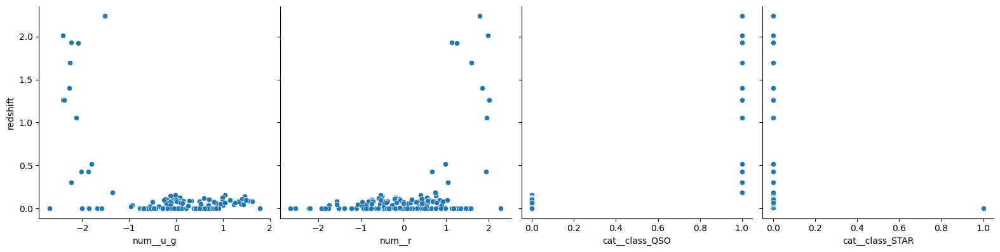

In [431]:

X_test_df["redshift"] = y_test.values

features3 = ["num__u_g", "num__r", "cat__class_QSO", "cat__class_STAR"]
g = sns.pairplot(X_test_df.sample(frac=0.2), height=4, y_vars="redshift", x_vars=features3, kind="scatter")

plt.show()



In [432]:
pd.DataFrame({"columns": features3, "coef": pipeline["model"].coef_})

,columns,coef
0,num__u_g,0.000979
1,num__r,0.018542
2,cat__class_QSO,1.203118
3,cat__class_STAR,-0.084947


In [433]:
pipeline["model"].intercept_

0.08654797901739583

In [434]:
y_train.mean(), y_test.mean()

(0.14440058436138864, 0.11462121050325447)

In [435]:
print("MAE:")
print("Train:", mean_absolute_error(y_train, pipeline.predict(X_train)))
print("Test:", mean_absolute_error(y_test, pipeline.predict(X_test)))
print("\nRMSE:")
print("Train:", np.sqrt(mean_squared_error(y_train, pipeline.predict(X_train))))
print("Test:", np.sqrt(mean_squared_error(y_test, pipeline.predict(X_test))))

MAE:
Train: 0.06290457817556572
Test: 0.05589154474650634

RMSE:
Train: 0.19914452482530287
Test: 0.16899995939949328


In [436]:
print("R2 Score Train:", r2_score(y_train, pipeline.predict(X_train)))
print("R2 Score Test:", r2_score(y_test, pipeline.predict(X_test)))

R2 Score Train: 0.7595288750732855
R2 Score Test: 0.7475288930449131


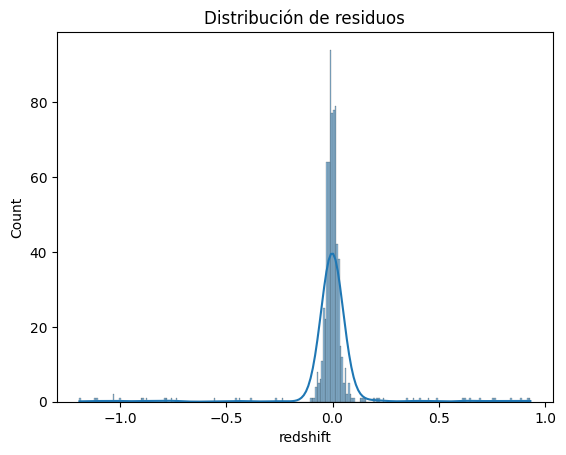

In [437]:
residuals = y_test - pipeline.predict(X_test)
sns.histplot(residuals, kde=True)
plt.title("Distribución de residuos")
plt.show()

Se puede evidenciar que la mayoria de predicciones frente a lo real presenta ujn residuo de 0, y este tiene una distribución normal, sin embargo presenta unos outliers.

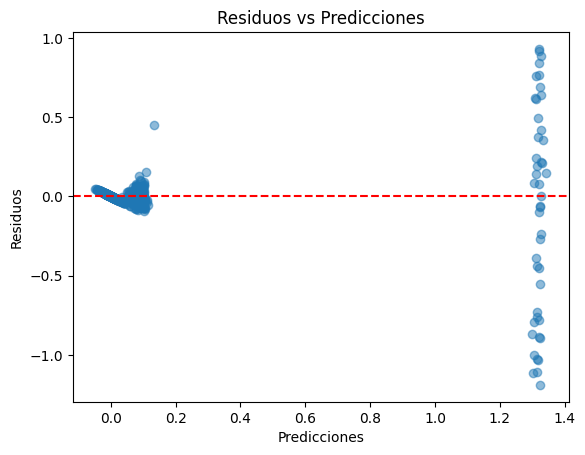

In [438]:
plt.scatter(pipeline.predict(X_test), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel("Predicciones")
plt.ylabel("Residuos")
plt.title("Residuos vs Predicciones")
plt.show()

#Se va a persistir el modelo

In [439]:
filename = "modelotelescope.joblib"

In [440]:
dump(pipeline, filename)

['modelotelescope.joblib']

In [441]:
pipeline_loaded = load(filename)

  Intento csv

In [442]:
modelo_cargado = joblib.load("/content/modelotelescope.joblib")
predicciones = modelo_cargado.predict(X_test)
resultados_df = pd.DataFrame({"redshift_real": y_test, "redshift_predicho": predicciones})
output_path = "/content/predicciones_telescope.csv"
resultados_df.to_csv(output_path, index=False)
print(f"Archivo CSV guardado en: {output_path}")


Archivo CSV guardado en: /content/predicciones_telescope.csv
